In [1]:
import random
import torch
import os
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.transforms as transforms
import torchvision.datasets as dsets
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from zipfile import ZipFile
from DCGAN_models import Generator, Discriminator

In [2]:
manualSeed = 999
random.seed(manualSeed)
torch.manual_seed(manualSeed)
torch.use_deterministic_algorithms(True)

In [5]:
dataset_link = 'https://s3-us-west-1.amazonaws.com/udacity-dlnfd/datasets/celeba.zip'

datafolder = "data/celeba"
local_datafolder = "datasets/celeba"

if os.path.exists(local_datafolder):
    dataroot = local_datafolder
else:
    os.system(f'wget {dataset_link} -P {datafolder}')
    dataset_zip = ZipFile(f'{datafolder}/celeba.zip')
    dataset_zip.extractall('/content/celeba')
    dataroot = "/content/celeba"

workers = 2

batch_size = 128

image_size = 64

nc = 3 # number of channels

nz = 100 # size of latent vector input

ngf = 64 # number of generator filters

ndf = 64 # number of discriminator filters

num_epochs = 5

lr = 2e-4

beta1 = 0.5 # beta for Adam optimizer

ngpu = 1 # number of gpus available

device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

In [6]:
dataset = dsets.ImageFolder(root = dataroot,
                            transform = transforms.Compose([
                                transforms.Resize(image_size),
                                transforms.CenterCrop(image_size),
                                transforms.ToTensor(),
                                transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                            ]))
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=workers)

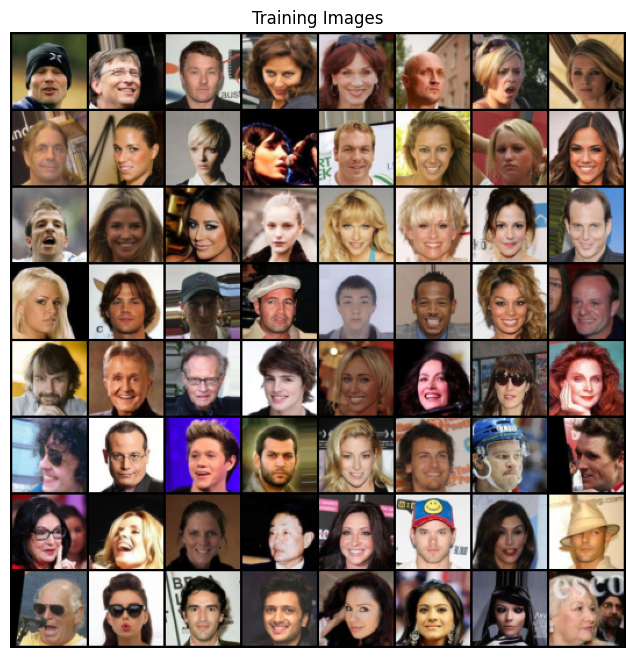

In [7]:
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(), (1, 2, 0)))
plt.show()

In [8]:
def weights_init(m):
  classname = m.__class__.__name__
  if classname.find('conv') != -1:
    nn.init.normal_(m.weight.data, 0.0, 0.02)
  elif classname.find('BatchNorm') != -1:
    nn.init.normal_(m.weight.data, 1.0, 0.02)
    nn.init.constant_(m.bias.data, 0)

In [10]:
netG = Generator(ngpu).to(device)

# for multi-gpu
if(device.type == 'cude') and (ngpu > 1):
  netG = nn.DataParallel(netG, list(range(ngpu)))

netG.apply(weights_init)

print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [12]:
netD = Discriminator(ngpu).to(device)

# for multi-gpu
if(device.type == 'cude') and (ngpu > 1):
  netD = nn.DataParallel(netD, list(range(ngpu)))

netD.apply(weights_init)

print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(2, 2), bias=False)
    (12): Sigmoid()
  )
)


In [13]:
criterion = nn.BCELoss()

fixed_noise = torch.randn(64, nz, 1, 1, device=device)

real_label = 1
fake_label = 0

optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [14]:
img_list = []
G_losses = []
D_losses = []
iters = 0

print('Starting Training Loop:')
for epoch in range(num_epochs):
  for i, data in enumerate(dataloader, 0):
    netD.zero_grad()
    real_cpu = data[0].to(device)
    b_size = real_cpu.size(0)
    label = torch.full((b_size, ), real_label, dtype=torch.float, device=device)
    output = netD(real_cpu).view(-1)
    errD_real = criterion(output, label)
    errD_real.backward()
    D_x = output.mean().item()
    noise = torch.randn(b_size, nz, 1, 1, device=device)
    fake = netG(noise)
    label.fill_(fake_label)
    output = netD(fake.detach()).view(-1)
    errD_fake = criterion(output, label)
    errD_fake.backward()
    D_G_z1 = output.mean().item()
    errD = errD_real + errD_fake
    optimizerD.step()
    netG.zero_grad()
    label.fill_(real_label)
    output = netD(fake).view(-1)
    errG = criterion(output, label)
    errG.backward()
    D_G_z2 = output.mean().item()
    optimizerG.step()

    if i % 50 == 0:
      print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

    G_losses.append(errG.item())
    D_losses.append(errD.item())

    if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
      with torch.no_grad():
        fake = netG(fixed_noise).detach().cpu()
      img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

    iters += 1


Starting Training Loop:
[0/5][0/1583]	Loss_D: 1.4315	Loss_G: 2.5808	D(x): 0.5041	D(G(z)): 0.5125 / 0.0795
[0/5][50/1583]	Loss_D: 0.4117	Loss_G: 11.5332	D(x): 0.9241	D(G(z)): 0.2498 / 0.0000
[0/5][100/1583]	Loss_D: 0.4756	Loss_G: 4.9376	D(x): 0.9063	D(G(z)): 0.2943 / 0.0084
[0/5][150/1583]	Loss_D: 0.7951	Loss_G: 2.7613	D(x): 0.6109	D(G(z)): 0.1617 / 0.0784
[0/5][200/1583]	Loss_D: 0.4467	Loss_G: 2.7994	D(x): 0.8076	D(G(z)): 0.1803 / 0.0875
[0/5][250/1583]	Loss_D: 0.6511	Loss_G: 3.2662	D(x): 0.7941	D(G(z)): 0.3005 / 0.0547
[0/5][300/1583]	Loss_D: 0.6100	Loss_G: 3.4697	D(x): 0.8162	D(G(z)): 0.2996 / 0.0425
[0/5][350/1583]	Loss_D: 0.7208	Loss_G: 3.6304	D(x): 0.8168	D(G(z)): 0.3693 / 0.0343
[0/5][400/1583]	Loss_D: 0.7725	Loss_G: 2.1652	D(x): 0.5457	D(G(z)): 0.0706 / 0.1499
[0/5][450/1583]	Loss_D: 0.7567	Loss_G: 4.4662	D(x): 0.8424	D(G(z)): 0.4014 / 0.0156
[0/5][500/1583]	Loss_D: 0.8358	Loss_G: 2.9047	D(x): 0.5163	D(G(z)): 0.0215 / 0.0811
[0/5][550/1583]	Loss_D: 0.8234	Loss_G: 1.5600	D(x): 0.

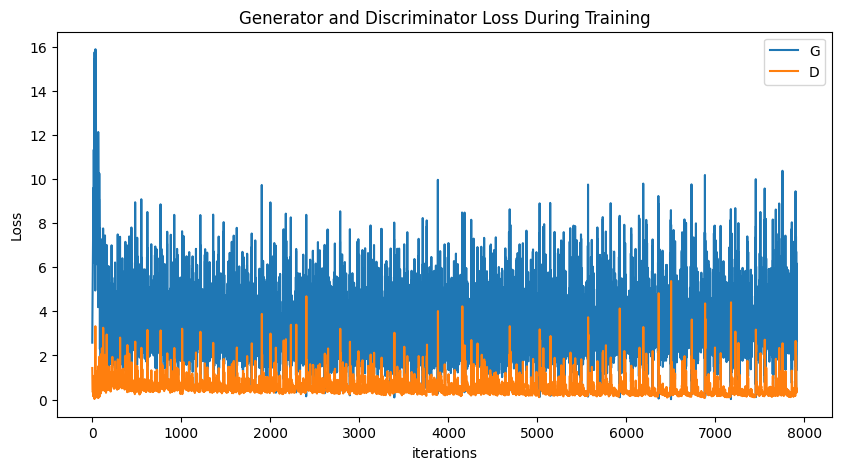

In [15]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

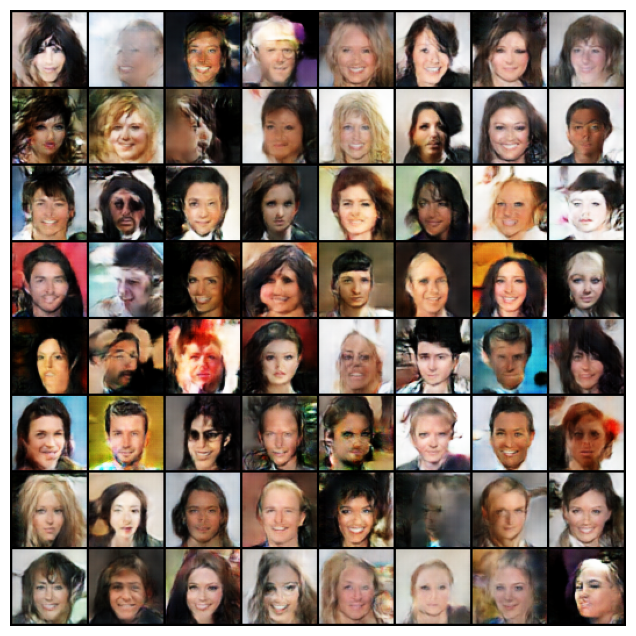

In [16]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

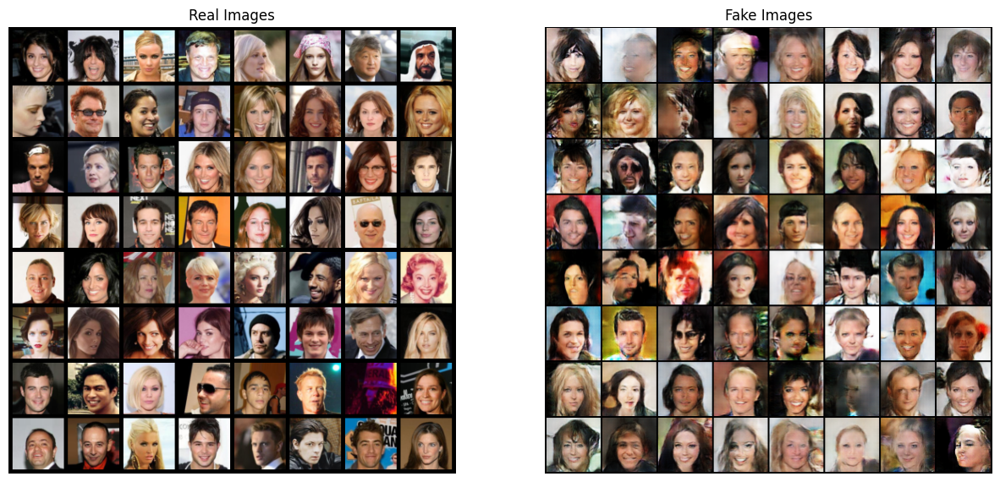

In [17]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

In [22]:
torch.save({
    'Discriminator_net': netD.state_dict(),
    'Discriminator_opt': optimizerD.state_dict(),
    'Generator_net': netG.state_dict(),
    'Generator_opt': optimizerG.state_dict(),
}, "./models/DCGAN")